In [1]:
import os
import numpy as np
import efficientnet.tfkeras
from tensorflow.keras.models import load_model
import tensorflow as tf
from focal_loss import BinaryFocalLoss
from tensorflow.keras import models

In [2]:
os.environ["CUDA_VISIBLE_DEVICES"]=""

# load model

In [3]:
model_dir ='/media/tohn/SSD/ModelTrainByImage/R2/models/B0R2_block3.h5'
model = load_model(model_dir)
height = width = model.input_shape[1]

x = model.get_layer('head_pooling').output
prediction_layer = model.output
model2 = models.Model(inputs= model.input, outputs=[prediction_layer,x]) 

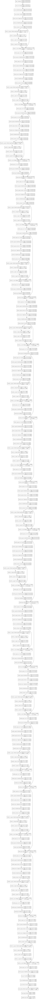

In [4]:
import tensorflow as tf

tf.keras.utils.plot_model(
    model2, to_file='model.png', show_shapes=True, show_layer_names=True,
    rankdir='TB', expand_nested=False, dpi=100
)

In [5]:
# validation
import pandas as pd
base_dir  = '/media/tohn/SSD/Image/validation/'
dataframe = pd.read_csv( '/home/yupaporn/codes/USAI/validationdf.csv')
validation_dir = os.path.join(base_dir, 'validation')

#Train
train_df = pd.read_csv( '/home/yupaporn/codes/USAI/traindf.csv')
base_dir0 = '/media/tohn/SSD/Image/'
os.chdir(base_dir0)
train_dir = os.path.join(base_dir0, 'train')

# Select Data

In [16]:
import pandas as pd
df0 = pd.read_csv (r'/home/yupaporn/codes/USAI/testdf.csv')
print(df0 .shape)
dataframe = df0[(df0['Path Crop']!='None' )&(df0['Path Crop']!='Nan')]
# a = df01[df01['Case'].between(1, 10)]
# dataframe = df01[df01['Abs Position']!='P8']
print(dataframe.shape)
print('Normal: ',dataframe[dataframe['Class']=='Normal'].shape)
print('Abnormal: ',dataframe[dataframe['Class']=='Abnormal'].shape)
dataframe.head(5)

(1325, 10)
(1325, 10)
Normal:  (930, 10)
Abnormal:  (395, 10)


,Unnamed: 0,Case,Abs Position,Sub Position,Class,Sub_class,Path Full,Path Crop,Views,fold
0,111,40,P1,P1,Abnormal,AB01,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,FP-A,2
1,112,40,P2,P2,Abnormal,AB01,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,FP-A,2
2,113,40,P4,P41,Abnormal,AB01,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,FP-B,2
3,114,40,P5,P51,Abnormal,AB01,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,FP-C,2
4,115,40,P3,P31,Abnormal,AB01,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...,FP-B,2


In [17]:
batch_size = 64
epochs = 10

from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(
      rescale=1./255,
      rotation_range=30,
      width_shift_range=0.2,
      height_shift_range=0.2,
      brightness_range=[0.5,1.5],
      shear_range=0.4,
      zoom_range=0.2,
      horizontal_flip=False,
      fill_mode='nearest')

train_generator = train_datagen.flow_from_dataframe(
        dataframe = dataframe,
        directory = train_dir,
        x_col = 'Path Crop',
        y_col = 'Class',
        target_size = (height, width),
        batch_size=batch_size,
        color_mode= 'rgb',
        class_mode='categorical')

#label
labels = (train_generator.class_indices)
labels = dict((v,k.replace("C","")) for k,v in labels.items())
print(labels)

Found 1325 validated image filenames belonging to 2 classes.
{0: 'Abnormal', 1: 'Normal'}


# Prediction

In [8]:
from tensorflow.keras.preprocessing import image
def predict_image(img_path):
    # Read the image and resize it
    img = image.load_img(img_path, target_size=(height, width))
    # Convert it to a Numpy array with target shape.
    x = image.img_to_array(img)
    # Reshape
    x = x.reshape((1,) + x.shape)
    x /= 255.
    result = model2.predict([x])
    result1 = result[0][0]
    result2 = result[1][0]


    return result1, result2

In [9]:
img_path = dataframe['Path Crop'][0]
img_path

'/media/tohn/HDD/VISION_dataset/USAI/ABnormal01/1 ABNORMAL/cropped/AB01 P5-2 C042.JPG'

In [11]:
result1, result2 = predict_image(img_path)
result2

array([-0.04054327, -0.05649742, -0.10245988, ..., -0.13840239,
       -0.14982812, -0.05848701], dtype=float32)

In [18]:
from tensorflow.keras.preprocessing import image
def predict_image(img_path):
    # Read the image and resize it
    img = image.load_img(img_path, target_size=(height, width))
    # Convert it to a Numpy array with target shape.
    x = image.img_to_array(img)
    # Reshape
    x = x.reshape((1,) + x.shape)
    x /= 255.
    result = model2.predict([x])
    result1 = result[0][0]
    result2 = result[1][0]


    return result1, result2

#Predict
pred_list = list()
prob_list = list()
vectorlist = list()
img_path=dataframe['Path Crop'].tolist()
for i in range(0,len(img_path)):
    result1, result2 = predict_image(img_path[i])
    pred_list.append(labels[np.argmax(result1)])
#     vectorlist.append({'features vector':result2})
    vectorlist.append(result2.tolist())
    if np.argmax(result1) == 0:
        prob_list.append(result1[0])
    else:
        prob_list.append(result1[1])
        
#     print(i)
#     print(np.argmax(predict_image(img_path[i])))

dataframe['category'] = pred_list
dataframe['Prob'] = prob_list
# dataframe['FeaturesVector'] = vectorlist

In [19]:
vectorlist

[[0.07173386961221695,
  0.23423749208450317,
  -0.1521749049425125,
  0.03717542812228203,
  -0.0523122102022171,
  0.09951194375753403,
  -0.1374962031841278,
  -0.11649678647518158,
  0.29798465967178345,
  -0.04223855584859848,
  -0.11974459886550903,
  0.06842981278896332,
  -0.03152808919548988,
  0.2336428165435791,
  0.1499660313129425,
  0.06748345494270325,
  0.17082639038562775,
  0.1378096342086792,
  -0.0009149243123829365,
  -0.16137026250362396,
  -0.1756734400987625,
  -0.07653270661830902,
  0.3991716206073761,
  -0.15169888734817505,
  -0.10728893429040909,
  0.21139436960220337,
  -0.1357668787240982,
  -0.15085573494434357,
  -0.15825022757053375,
  -0.14685873687267303,
  -0.12650775909423828,
  -0.08528652787208557,
  -0.08139348030090332,
  -0.13507278263568878,
  -0.05541127547621727,
  -0.12874054908752441,
  -0.13070476055145264,
  -0.09176748991012573,
  -0.07476562261581421,
  -0.04710008576512337,
  -0.00039106106851249933,
  -0.08892486244440079,
  0.03460

In [20]:
vector_array = np.array(vectorlist)
vector_array

array([[ 0.07173387,  0.23423749, -0.1521749 , ..., -0.09841589,
        -0.11782444, -0.16236772],
       [-0.0288067 , -0.07498065, -0.13909081, ...,  0.08968098,
        -0.02328038, -0.0507737 ],
       [ 0.26570383, -0.13368113, -0.02240117, ..., -0.05099273,
        -0.02299882, -0.02564256],
       ...,
       [-0.11771609, -0.09337704,  0.13897665, ...,  0.01410605,
         0.40083811, -0.1728199 ],
       [ 0.13935471, -0.09240595, -0.15411986, ..., -0.07461352,
        -0.06643771, -0.16487648],
       [ 0.22451466, -0.10322311,  0.43005767, ...,  0.22877005,
         0.29036957,  0.0008021 ]])

In [21]:
dataset = pd.DataFrame(vector_array[:, :])
dataset

,0,1,2,3,4,5,6,7,8,9,...,1270,1271,1272,1273,1274,1275,1276,1277,1278,1279
0,0.071734,0.234237,-0.152175,0.037175,-0.052312,0.099512,-0.137496,-0.116497,0.297985,-0.042239,...,0.047967,-0.057921,0.589214,0.818873,-0.158095,-0.051186,0.094768,-0.098416,-0.117824,-0.162368
1,-0.028807,-0.074981,-0.139091,0.083790,0.309040,-0.117991,-0.142933,-0.107684,0.838374,0.181082,...,-0.115450,-0.118433,0.542102,0.894148,-0.101787,0.034452,0.040677,0.089681,-0.023280,-0.050774
2,0.265704,-0.133681,-0.022401,-0.090378,0.087018,-0.145152,-0.097587,-0.026338,1.268950,0.022391,...,0.108724,-0.134549,0.064721,0.398253,-0.112497,-0.151920,-0.000612,-0.050993,-0.022999,-0.025643
3,-0.126310,-0.145253,-0.113543,-0.094023,-0.155109,-0.126996,-0.118148,-0.088686,1.008916,-0.049534,...,-0.024788,-0.136772,1.548023,0.906361,0.083297,-0.090106,-0.163680,-0.118194,-0.110162,0.016890
4,-0.106692,-0.127604,-0.021512,0.131754,-0.168597,-0.124227,-0.107892,-0.067833,0.554358,0.340720,...,-0.084550,-0.054930,1.032004,0.693786,0.066189,-0.091457,0.289298,-0.108226,-0.044664,-0.099523
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1320,0.007496,0.340673,0.076471,0.197735,0.644747,-0.052640,0.183237,0.353226,0.333725,0.597423,...,0.220640,-0.099028,0.020960,0.114990,0.015840,0.557363,-0.058356,-0.008176,0.345939,0.077566
1321,0.270852,0.097892,-0.157706,-0.152551,-0.115337,-0.111331,0.097826,-0.081520,0.354217,0.677285,...,0.064829,-0.079836,-0.139450,-0.100440,-0.082943,-0.017474,-0.155814,-0.102846,-0.132122,0.017948
1322,-0.117716,-0.093377,0.138977,-0.091486,-0.150990,0.100741,-0.151626,-0.092851,-0.049638,-0.027973,...,-0.082127,-0.102948,0.362695,-0.084315,-0.156494,0.001921,-0.006510,0.014106,0.400838,-0.172820
1323,0.139355,-0.092406,-0.154120,-0.169314,0.068970,0.008527,-0.137904,-0.076584,-0.033921,-0.056985,...,0.154448,0.124553,-0.135982,-0.157855,-0.163125,0.293603,-0.063924,-0.074614,-0.066438,-0.164876


In [22]:
a = dataframe['Class'].tolist()
b = dataframe['Sub Position'].tolist()
c = dataframe['Views'].tolist()
dataset['Class'] = a 
dataset['SubPosition'] = b
dataset['Views'] = c

In [23]:
dataset

,0,1,2,3,4,5,6,7,8,9,...,1273,1274,1275,1276,1277,1278,1279,Class,SubPosition,Views
0,0.071734,0.234237,-0.152175,0.037175,-0.052312,0.099512,-0.137496,-0.116497,0.297985,-0.042239,...,0.818873,-0.158095,-0.051186,0.094768,-0.098416,-0.117824,-0.162368,Abnormal,P1,FP-A
1,-0.028807,-0.074981,-0.139091,0.083790,0.309040,-0.117991,-0.142933,-0.107684,0.838374,0.181082,...,0.894148,-0.101787,0.034452,0.040677,0.089681,-0.023280,-0.050774,Abnormal,P2,FP-A
2,0.265704,-0.133681,-0.022401,-0.090378,0.087018,-0.145152,-0.097587,-0.026338,1.268950,0.022391,...,0.398253,-0.112497,-0.151920,-0.000612,-0.050993,-0.022999,-0.025643,Abnormal,P41,FP-B
3,-0.126310,-0.145253,-0.113543,-0.094023,-0.155109,-0.126996,-0.118148,-0.088686,1.008916,-0.049534,...,0.906361,0.083297,-0.090106,-0.163680,-0.118194,-0.110162,0.016890,Abnormal,P51,FP-C
4,-0.106692,-0.127604,-0.021512,0.131754,-0.168597,-0.124227,-0.107892,-0.067833,0.554358,0.340720,...,0.693786,0.066189,-0.091457,0.289298,-0.108226,-0.044664,-0.099523,Abnormal,P31,FP-B
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1320,0.007496,0.340673,0.076471,0.197735,0.644747,-0.052640,0.183237,0.353226,0.333725,0.597423,...,0.114990,0.015840,0.557363,-0.058356,-0.008176,0.345939,0.077566,Normal,P72,FP-D
1321,0.270852,0.097892,-0.157706,-0.152551,-0.115337,-0.111331,0.097826,-0.081520,0.354217,0.677285,...,-0.100440,-0.082943,-0.017474,-0.155814,-0.102846,-0.132122,0.017948,Normal,P72,FP-D
1322,-0.117716,-0.093377,0.138977,-0.091486,-0.150990,0.100741,-0.151626,-0.092851,-0.049638,-0.027973,...,-0.084315,-0.156494,0.001921,-0.006510,0.014106,0.400838,-0.172820,Normal,P72,FP-D
1323,0.139355,-0.092406,-0.154120,-0.169314,0.068970,0.008527,-0.137904,-0.076584,-0.033921,-0.056985,...,-0.157855,-0.163125,0.293603,-0.063924,-0.074614,-0.066438,-0.164876,Normal,P72,FP-D


In [24]:
# os.chdir( '/home/yupaporn/codes/USAI/')
# dataset.to_csv('FeaturesVector_test.csv')

# Visualization

In [9]:
data_train = dataframe
#เช็คคลาสใน Predicted
pred_class = set(data_train['category'])
print('Predicted : ',len(pred_class))
print(pred_class)
#เช็คคลาสใน Actual
classe = set(data_train['Class'])
print('Actual : ',len(classe))
print(classe)

Predicted :  2
{'Normal', 'Abnormal'}
Actual :  2
{'Normal', 'Abnormal'}


In [10]:
import numpy as np
from sklearn.metrics import confusion_matrix
act = data_train['Class'].array
pred = data_train['category'].array

cmat = confusion_matrix(act, pred)
print('classifier accuracy = {}%'.format((100.*np.trace(cmat))/(np.sum(cmat))))

#Marking the Confusion Matrix
from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(act, pred))#performance

classifier accuracy = 88.51454823889739%
              precision    recall  f1-score   support

    Abnormal       0.79      0.84      0.82       197
      Normal       0.93      0.90      0.92       456

    accuracy                           0.89       653
   macro avg       0.86      0.87      0.87       653
weighted avg       0.89      0.89      0.89       653



### Confusion matrix

Text(0.5, 21.5, 'Predicted label')

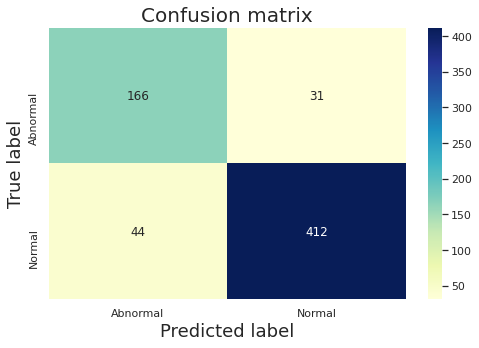

In [11]:
#create CF 
data = {'Actual': act,'Predicted' : pred,}
df = pd.DataFrame(data, columns=['Actual','Predicted'])
conf_mat = pd.crosstab(df['Actual'],df['Predicted'],rownames=['Actual'],colnames=['Predicted'])

#Confusion matrix
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(act, pred)

#plot Confusion matrix
import seaborn as sns
sns.set()
fig, ax = plt.subplots(figsize=(8, 5))

ax = sns.heatmap(conf_mat, annot=True, fmt="d", cmap="YlGnBu") #Blues,Oranges,Reds
ax.set_title('Confusion matrix',fontsize=20)
ax.set_ylabel('True label',fontsize=18)
ax.set_xlabel('Predicted label',fontsize=18)

### ROC curve 

#### -  confusion_matrix function 

In [12]:
def confusion_matrix_all(data_train,threshold):

    #1. manage data  --------------------------------------------------------------------------------------------------------------------------------------------------

    p1 = data_train #Input table   
    act= p1['Class'].map({'Normal':0,'Abnormal':1}).values
    pred = p1['category'].map({'Normal':0,'Abnormal':1}).values

    import numpy as np
    n = len(p1)
    proplist = list()
    for i in range(0,n):
        score = p1.iloc[i].to_numpy()
        if score[10]=='Normal':
            prob = 1 - score[11]
            proplist.append(prob)
        else:
            prob = score[11]
            proplist.append(prob)


    prob_all =np.array(proplist)

#2. เงื่อนไข ---------------------------------------------------------------------------------------------------------------------------------------------
    
    import numpy as np
    from sklearn.metrics import confusion_matrix

    TN, FP, FN, TP = confusion_matrix(act, pred).ravel()
    print(TN, FP, FN, TP)

# 3. threshold ----------------------------------------------------------------


    import numpy as np
    from sklearn.metrics import confusion_matrix
    
    t = prob_all >= threshold
    #replace
    ts =t.tolist()
    alist =list()
    for i in range(0,len(ts)):
        if ts[i]==  True:
            a = 1
            alist.append(a)
        else:
            a = 0
            alist.append(a)

    tn, fp, fn, tp = confusion_matrix(act, alist).ravel()

    print('(TN,FP,FN,TP)')
    print('(',tn,',', fp,',', fn,',', tp,')')
    return tn, fp, fn, tp


In [13]:
#Test function
threshold = 0.5
confusion_matrix_all(data_train,threshold)

412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )


(412, 44, 31, 166)

#### -  run ROC curve

In [14]:
import numpy as np
threshold = np.arange(0.0, 1.002, 0.001)
precision, recall, ACC, TPR, FPR, SPEC = list(),list(),list(),list(),list(),list()
TN0, FP0, FN0, TP0 = list(),list(),list(),list()
for i in threshold:
    precision0, recall0, ACC0, TPR0, FPR0, SPEC0 = list(),list(),list(),list(),list(),list()
    
    tn,fp,fn,tp = confusion_matrix_all(data_train,i) 
    try:
        pre = tp/(tp+fp)
        re= tp/(tp+fn)
        acc = (tp+tn)/(tp+tn+fp+fn)
        tpr = tp/(tp+fn)
        fpr = fp/(fp+tn)
        spec = 1-(tn/(tn+fp))
    except ZeroDivisionError:
        pre,re,acc,tpr,fpr,spec =1,0,0,0,0,0      
            
    TP0.append(tp)
    TN0.append(tn)
    FP0.append(fp)
    FN0.append(fn)
    precision0.append(pre)
    recall0.append(re)
    ACC0.append(acc)
    TPR0.append(re)
    FPR0.append(fpr)       
    SPEC0.append(spec)
        
    precision.append(precision0)
    recall.append(recall0)
    ACC.append(ACC0)
    TPR.append(TPR0)
    FPR.append(FPR0)       
    SPEC.append(SPEC0)

412 44 31 166
(TN,FP,FN,TP)
( 0 , 456 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 292 , 164 , 1 , 196 )
412 44 31 166
(TN,FP,FN,TP)
( 307 , 149 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 314 , 142 , 4 , 193 )
412 44 31 166
(TN,FP,FN,TP)
( 322 , 134 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 334 , 122 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 338 , 118 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 341 , 115 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 344 , 112 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 345 , 111 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 349 , 107 , 9 , 188 )
412 44 31 166
(TN,FP,FN,TP)
( 350 , 106 , 9 , 188 )
412 44 31 166
(TN,FP,FN,TP)
( 350 , 106 , 9 , 188 )
412 44 31 166
(TN,FP,FN,TP)
( 352 , 104 , 9 , 188 )
412 44 31 166
(TN,FP,FN,TP)
( 353 , 103 , 9 , 188 )
412 44 31 166
(TN,FP,FN,TP)
( 354 , 102 , 9 , 188 )
412 44 31 166


412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 396 , 60 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 397 , 59 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 397 , 59 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 397 , 59 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 397 , 59 , 17 , 180 )
412 44 31 166
(TN,FP,FN,TP)
( 397 , 59 , 17 , 180 )
412 44 31 16

412 44 31 166
(TN,FP,FN,TP)
( 406 , 50 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 406 , 50 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 406 , 50 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 407 , 49 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 408 , 48 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 408 , 48 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 408 , 48 , 27 , 170 )
412 44 31 166
(TN,FP,FN,TP)
( 408 , 48 , 27 , 170 )
412 44 31 16

412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 166
(TN,FP,FN,TP)
( 412 , 44 , 31 , 166 )
412 44 31 16

412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 166
(TN,FP,FN,TP)
( 417 , 39 , 40 , 157 )
412 44 31 16

412 44 31 166
(TN,FP,FN,TP)
( 422 , 34 , 47 , 150 )
412 44 31 166
(TN,FP,FN,TP)
( 422 , 34 , 47 , 150 )
412 44 31 166
(TN,FP,FN,TP)
( 422 , 34 , 47 , 150 )
412 44 31 166
(TN,FP,FN,TP)
( 422 , 34 , 47 , 150 )
412 44 31 166
(TN,FP,FN,TP)
( 422 , 34 , 47 , 150 )
412 44 31 166
(TN,FP,FN,TP)
( 422 , 34 , 47 , 150 )
412 44 31 166
(TN,FP,FN,TP)
( 422 , 34 , 47 , 150 )
412 44 31 166
(TN,FP,FN,TP)
( 422 , 34 , 47 , 150 )
412 44 31 166
(TN,FP,FN,TP)
( 422 , 34 , 47 , 150 )
412 44 31 166
(TN,FP,FN,TP)
( 422 , 34 , 47 , 150 )
412 44 31 166
(TN,FP,FN,TP)
( 423 , 33 , 48 , 149 )
412 44 31 166
(TN,FP,FN,TP)
( 423 , 33 , 48 , 149 )
412 44 31 166
(TN,FP,FN,TP)
( 423 , 33 , 48 , 149 )
412 44 31 166
(TN,FP,FN,TP)
( 423 , 33 , 48 , 149 )
412 44 31 166
(TN,FP,FN,TP)
( 423 , 33 , 48 , 149 )
412 44 31 166
(TN,FP,FN,TP)
( 423 , 33 , 48 , 149 )
412 44 31 166
(TN,FP,FN,TP)
( 423 , 33 , 49 , 148 )
412 44 31 166
(TN,FP,FN,TP)
( 423 , 33 , 49 , 148 )
412 44 31 166
(TN,FP,FN,TP)
( 423 , 33 , 49 , 148 )
412 44 31 16

412 44 31 166
(TN,FP,FN,TP)
( 437 , 19 , 75 , 122 )
412 44 31 166
(TN,FP,FN,TP)
( 437 , 19 , 75 , 122 )
412 44 31 166
(TN,FP,FN,TP)
( 437 , 19 , 75 , 122 )
412 44 31 166
(TN,FP,FN,TP)
( 438 , 18 , 75 , 122 )
412 44 31 166
(TN,FP,FN,TP)
( 438 , 18 , 76 , 121 )
412 44 31 166
(TN,FP,FN,TP)
( 438 , 18 , 77 , 120 )
412 44 31 166
(TN,FP,FN,TP)
( 438 , 18 , 79 , 118 )
412 44 31 166
(TN,FP,FN,TP)
( 438 , 18 , 81 , 116 )
412 44 31 166
(TN,FP,FN,TP)
( 438 , 18 , 83 , 114 )
412 44 31 166
(TN,FP,FN,TP)
( 438 , 18 , 83 , 114 )
412 44 31 166
(TN,FP,FN,TP)
( 438 , 18 , 83 , 114 )
412 44 31 166
(TN,FP,FN,TP)
( 438 , 18 , 83 , 114 )
412 44 31 166
(TN,FP,FN,TP)
( 438 , 18 , 84 , 113 )
412 44 31 166
(TN,FP,FN,TP)
( 439 , 17 , 86 , 111 )
412 44 31 166
(TN,FP,FN,TP)
( 439 , 17 , 86 , 111 )
412 44 31 166
(TN,FP,FN,TP)
( 441 , 15 , 86 , 111 )
412 44 31 166
(TN,FP,FN,TP)
( 441 , 15 , 86 , 111 )
412 44 31 166
(TN,FP,FN,TP)
( 441 , 15 , 87 , 110 )
412 44 31 166
(TN,FP,FN,TP)
( 442 , 14 , 87 , 110 )
412 44 31 16

/home/yupaporn/.local/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in long_scalars
  # Remove the CWD from sys.path while we load stuff.


In [15]:
#average per threshold 
precision1,recall1,ACC1,TPR1,FPR1,SPEC1 = list(),list(),list(),list(),list(),list()
from statistics import *
for m in range(0,len(precision)):
    a1 =mean(precision[m])
    a2 =mean(recall[m])
    a3 =mean(ACC[m])
    a4 =mean(TPR[m])
    a5 =mean(FPR[m])
    a6 =mean(SPEC[m])
    
    precision1.append(a1)
    recall1.append(a2)
    ACC1.append(a3)
    TPR1.append(a4)
    FPR1.append(a5)       
    SPEC1.append(a6)   

In [16]:
#create dataframe
import numpy as np
i = np.arange(len(precision1)) # index for df
roc0 = pd.DataFrame({'Threshold' : pd.Series(threshold, index=i),'Precision' : pd.Series(precision1, index = i),'Recall' : pd.Series(recall1, index = i),
                     'tpr' : pd.Series(TPR1, index = i),'fpr' : pd.Series(FPR1, index = i),'1-Spec' : pd.Series(SPEC1, index = i),  'ACC' : pd.Series(ACC1, index = i), 
                     'TN' : pd.Series(TN0, index = i), 'FP' : pd.Series(FP0, index = i), 'FN' : pd.Series(FN0, index = i), 'TP' : pd.Series(TP0, index = i)},)
roc0 = roc0.fillna(1)

In [17]:
roc0.head(10)

,Threshold,Precision,Recall,tpr,fpr,1-Spec,ACC,TN,FP,FN,TP
0,0.000,0.301685,1.000000,1.000000,1.000000,1.000000,0.301685,0,456,0,197
1,0.001,0.544444,0.994924,0.994924,0.359649,0.359649,0.747320,292,164,1,196
2,0.002,0.565598,0.984772,0.984772,0.326754,0.326754,0.767228,307,149,3,194
3,0.003,0.576119,0.979695,0.979695,0.311404,0.311404,0.776417,314,142,4,193
4,0.004,0.588957,0.974619,0.974619,0.293860,0.293860,0.787136,322,134,5,192
5,0.005,0.601881,0.974619,0.974619,0.278509,0.278509,0.797856,329,127,5,192
6,0.006,0.604430,0.969543,0.969543,0.274123,0.274123,0.799387,331,125,6,191
7,0.007,0.607717,0.959391,0.959391,0.267544,0.267544,0.800919,334,122,8,189
8,0.008,0.613636,0.959391,0.959391,0.260965,0.260965,0.805513,337,119,8,189
9,0.009,0.615635,0.959391,0.959391,0.258772,0.258772,0.807044,338,118,8,189


#### -  sen VS spec

No handles with labels found to put in legend.


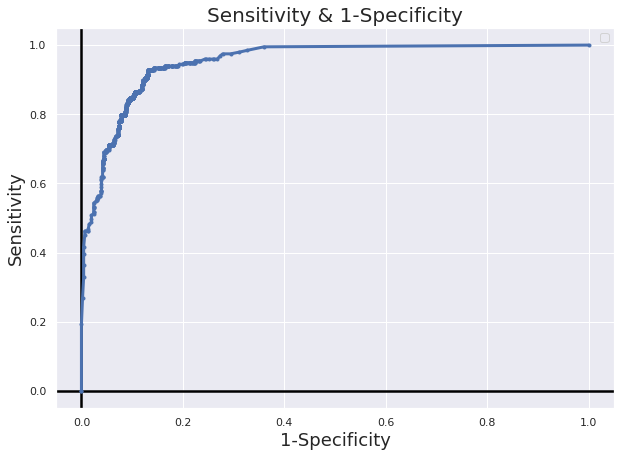

PR AUC (area = 0.95)


In [18]:
#sen VS spec
import numpy as np
import matplotlib.pyplot as plt
sen= np.array(roc0['tpr'])
spec = np.array(roc0['1-Spec'])
# from matplotlib import pyplot
lw = 3
fig, ax = plt.subplots(figsize=(10, 7))
plt.axhline(0, lw=2.5, color='black')
plt.axvline(0, lw=2.5, color='black')
plt.plot([0, 0],[1, 1],'c', linestyle='--',lw=2.5)
plt.plot(spec,sen,'b', marker='.',lw=lw)  
    # axis labels
plt.xlabel('1-Specificity',fontsize=18)
plt.ylabel('Sensitivity',fontsize=18)
plt.title('Sensitivity & 1-Specificity',fontsize=20)
    # show the legend
plt.legend()
    # show the plot
plt.show()
    # calculate the precision-recall auc
from sklearn.metrics import auc
auc_score = auc(spec, sen)
print('PR AUC (area = %0.2f)' % (auc_score))

#### -  Precision & Recall Curve

No handles with labels found to put in legend.


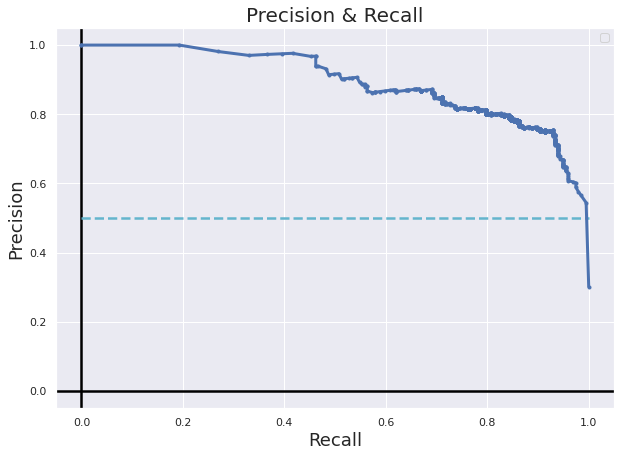

PR AUC (area = 0.89)


In [19]:
#Precision & Recall Curve
import numpy as np
recall = np.array(roc0['Recall'])
precision = np.array(roc0['Precision'])

import matplotlib.pyplot as plt
from matplotlib import pyplot
lw = 3
fig, ax = plt.subplots(figsize=(10, 7))
plt.axhline(0, lw=2.5, color='black')
plt.axvline(0, lw=2.5, color='black')
fig.patch.set_facecolor('w')
plt.plot([0, 1], [0.5, 0.5],'c', linestyle='--',lw=2.5)
pyplot.plot(recall, precision,'b', marker='.', lw=lw)
    # axis labels
pyplot.xlabel('Recall',fontsize=18)
pyplot.ylabel('Precision',fontsize=18)
pyplot.title('Precision & Recall',fontsize=20)
    # show the legend
pyplot.legend()
    # show the plot
pyplot.show()
    # calculate the precision-recall auc
from sklearn.metrics import auc
auc_score = auc(recall, precision)
print('PR AUC (area = %0.2f)' % (auc_score))

## Threshold 

In [20]:
#Select the best threshold
FN_min = roc0[roc0.FN == roc0.FN.min()]
FP_min = FN_min[FN_min.FP == FN_min.FP.min()]
FP_min

,Threshold,Precision,Recall,tpr,fpr,1-Spec,ACC,TN,FP,FN,TP
0,0.0,0.301685,1.0,1.0,1.0,1.0,0.301685,0,456,0,197


In [21]:
import numpy as np
# threshold = np.arange(0.0, 1.002, 0.001)
threshold = np.arange(0.0, 0.01, 0.00001)
precision, recall, ACC, TPR, FPR, SPEC = list(),list(),list(),list(),list(),list()
TN0, FP0, FN0, TP0 = list(),list(),list(),list()
for i in threshold:
    precision0, recall0, ACC0, TPR0, FPR0, SPEC0 = list(),list(),list(),list(),list(),list()
    
    tn,fp,fn,tp = confusion_matrix_all(data_train,i) 
    try:
        pre = tp/(tp+fp)
        re= tp/(tp+fn)
        acc = (tp+tn)/(tp+tn+fp+fn)
        tpr = tp/(tp+fn)
        fpr = fp/(fp+tn)
        spec = 1-(tn/(tn+fp))
    except ZeroDivisionError:
        pre,re,acc,tpr,fpr,spec =1,0,0,0,0,0      
            
    TP0.append(tp)
    TN0.append(tn)
    FP0.append(fp)
    FN0.append(fn)
    precision0.append(pre)
    recall0.append(re)
    ACC0.append(acc)
    TPR0.append(re)
    FPR0.append(fpr)       
    SPEC0.append(spec)
        
    precision.append(precision0)
    recall.append(recall0)
    ACC.append(ACC0)
    TPR.append(TPR0)
    FPR.append(FPR0)       
    SPEC.append(SPEC0)

412 44 31 166
(TN,FP,FN,TP)
( 0 , 456 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 187 , 269 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 199 , 257 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 207 , 249 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 212 , 244 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 217 , 239 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 221 , 235 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 227 , 229 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 230 , 226 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 236 , 220 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 240 , 216 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 241 , 215 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 242 , 214 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 244 , 212 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 246 , 210 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 246 , 210 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 247 , 209 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 249 , 207 , 0 , 197 )
412 44 31 166
(TN,FP,FN,TP)
( 251 , 205 , 0 , 197 )
412 44 31 166


( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 301 , 155 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 302 , 154 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 302 , 154 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 302 , 154 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 302 , 154 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 302 , 154 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 303 , 153 , 3 , 194 )
412 44 31 166
(TN,FP,FN,TP)
( 303 , 153 

412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 4 , 193 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 4 , 193 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 4 , 193 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 4 , 193 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 4 , 193 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 4 , 193 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 4 , 193 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 315 , 141 , 5 , 192 )
412 44 31 16

412 44 31 166
(TN,FP,FN,TP)
( 328 , 128 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 328 , 128 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 328 , 128 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 328 , 128 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 166
(TN,FP,FN,TP)
( 329 , 127 , 5 , 192 )
412 44 31 16

412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 331 , 125 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 332 , 124 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 332 , 124 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 332 , 124 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 332 , 124 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 332 , 124 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 332 , 124 , 6 , 191 )
412 44 31 166
(TN,FP,FN,TP)
( 332 , 124 , 6 , 191 )
412 44 31 16

412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 337 , 119 , 8 , 189 )
412 44 31 16

412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 166
(TN,FP,FN,TP)
( 340 , 116 , 8 , 189 )
412 44 31 16

In [22]:
#average per threshold 
precision1,recall1,ACC1,TPR1,FPR1,SPEC1 = list(),list(),list(),list(),list(),list()
from statistics import *
for m in range(0,len(precision)):
    a1 =mean(precision[m])
    a2 =mean(recall[m])
    a3 =mean(ACC[m])
    a4 =mean(TPR[m])
    a5 =mean(FPR[m])
    a6 =mean(SPEC[m])
    
    precision1.append(a1)
    recall1.append(a2)
    ACC1.append(a3)
    TPR1.append(a4)
    FPR1.append(a5)       
    SPEC1.append(a6)   

In [23]:
#create dataframe
import numpy as np
i = np.arange(len(precision1)) # index for df
roc0 = pd.DataFrame({'Threshold' : pd.Series(threshold, index=i),'Precision' : pd.Series(precision1, index = i),'Recall' : pd.Series(recall1, index = i),
                     'tpr' : pd.Series(TPR1, index = i),'fpr' : pd.Series(FPR1, index = i),'1-Spec' : pd.Series(SPEC1, index = i),  'ACC' : pd.Series(ACC1, index = i), 
                     'TN' : pd.Series(TN0, index = i), 'FP' : pd.Series(FP0, index = i), 'FN' : pd.Series(FN0, index = i), 'TP' : pd.Series(TP0, index = i)},)
roc0 = roc0.fillna(1)

In [24]:
#Select the best threshold
FN_min = roc0[roc0.FN == roc0.FN.min()]
FP_min = FN_min[FN_min.FP == FN_min.FP.min()]
FP_min

,Threshold,Precision,Recall,tpr,fpr,1-Spec,ACC,TN,FP,FN,TP
76,0.00076,0.532432,1.0,1.0,0.379386,0.379386,0.735069,283,173,0,197
77,0.00077,0.532432,1.0,1.0,0.379386,0.379386,0.735069,283,173,0,197
78,0.00078,0.532432,1.0,1.0,0.379386,0.379386,0.735069,283,173,0,197


In [25]:
threshold = FP_min['Threshold'].tolist()[0]
threshold

0.00076

In [27]:


    #1. manage data  --------------------------------------------------------------------------------------------------------------------------------------------------

    p1 = data_train #Input table   
    act= p1['Class'].map({'Normal':0,'Abnormal':1}).values
    pred = p1['category'].map({'Normal':0,'Abnormal':1}).values

    import numpy as np
    n = len(p1)
    proplist = list()
    for i in range(0,n):
        score = p1.iloc[i].to_numpy()
        if score[10]=='Normal':
            prob = 1 - score[11]
            proplist.append(prob)
        else:
            prob = score[11]
            proplist.append(prob)


    prob_all =np.array(proplist)

#2. เงื่อนไข ---------------------------------------------------------------------------------------------------------------------------------------------
    
    import numpy as np
    from sklearn.metrics import confusion_matrix

    TN, FP, FN, TP = confusion_matrix(act, pred).ravel()
    print(TN, FP, FN, TP)

# 3. threshold ----------------------------------------------------------------


    import numpy as np
    from sklearn.metrics import confusion_matrix
    
    t = prob_all >= threshold
    #replace
    ts =t.tolist()
    alist =list()
    for i in range(0,len(ts)):
        if ts[i]==  True:
            a = 1
            alist.append(a)
        else:
            a = 0
            alist.append(a)

    tn, fp, fn, tp = confusion_matrix(act, alist).ravel()

    print('(TN,FP,FN,TP)')
    print('(',tn,',', fp,',', fn,',', tp,')')



412 44 31 166
(TN,FP,FN,TP)
( 283 , 173 , 0 , 197 )


In [28]:
#Marking the Confusion Matrix
from sklearn.metrics import classification_report,confusion_matrix
# confusion_matrix(act, pred)
print(classification_report(act, alist))#performance

              precision    recall  f1-score   support

           0       1.00      0.62      0.77       456
           1       0.53      1.00      0.69       197

    accuracy                           0.74       653
   macro avg       0.77      0.81      0.73       653
weighted avg       0.86      0.74      0.74       653



In [29]:
#replace
#0,1 -> Abnormal,Normal
pred_theshold =list()
for i in range(0,len(alist)):
    if alist[i]== 1:
        a = 'Abnormal'
        pred_theshold.append(a)
    else:
        a = 'Normal'
        pred_theshold.append(a)

In [30]:
#prob
import numpy as np
n = len(p1)
proplist = list()
for i in range(0,n):
    score = p1.iloc[i].to_numpy()
    if score[10]=='Normal':
        prob = 1 - score[11]
        proplist.append(prob)
    else:
        prob = score[11]
        proplist.append(prob)

prob_all =np.array(proplist)


resdf = list()
import numpy as np

act= p1['Class']
prob= p1['category']
path_= p1['Path Crop']
SubPosi= p1['Sub Position']

act = act.reset_index(drop=True)
prob = prob.reset_index(drop=True)
path_ = path_.reset_index(drop=True)
SubPosi = SubPosi.reset_index(drop=True)

for i in range(0,len(p1)):
    act_true = act[i]
    pred_max= pred_theshold[i]
    prob_new= prob[i]
    prob_old = prob_all[i]
    subposi = SubPosi[i]
    path = path_[i]
    
    resdf.append({'SubPosition':subposi,'Actual':act_true,'Predicted':pred_max, 'prob_new':prob_new, 'prob_old':prob_old, 'path':path})
res_df = pd.DataFrame(resdf)
res_df

,SubPosition,Actual,Predicted,prob_new,prob_old,path
0,P31,Abnormal,Abnormal,Abnormal,0.984764,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...
1,P1,Abnormal,Abnormal,Abnormal,0.993474,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...
2,P2,Abnormal,Abnormal,Abnormal,0.973560,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...
3,P42,Abnormal,Abnormal,Abnormal,0.992543,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...
4,P41,Abnormal,Abnormal,Abnormal,0.814705,/media/tohn/HDD/VISION_dataset/USAI/ABnormal01...
...,...,...,...,...,...,...
648,P72,Normal,Normal,Normal,0.000511,/media/tohn/HDD/VISION_dataset/USAI/FPD JULY 2...
649,P72,Normal,Abnormal,Abnormal,0.682753,/media/tohn/HDD/VISION_dataset/USAI/FPD JULY 2...
650,P72,Normal,Abnormal,Abnormal,0.872073,/media/tohn/HDD/VISION_dataset/USAI/FPD JULY 2...
651,P72,Normal,Abnormal,Abnormal,0.997131,/media/tohn/HDD/VISION_dataset/USAI/FPD JULY 2...


In [31]:
data = {'Actual': act,'Predicted' : pred_theshold,}
df = pd.DataFrame(data, columns=['Actual','Predicted'])
conf_mat = pd.crosstab(df['Actual'],df['Predicted'],rownames=['Actual'],colnames=['Predicted'])
conf_mat

Predicted,Abnormal,Normal
Actual,,
Abnormal,197,0
Normal,173,283


Text(0.5, 21.5, 'Predicted label')

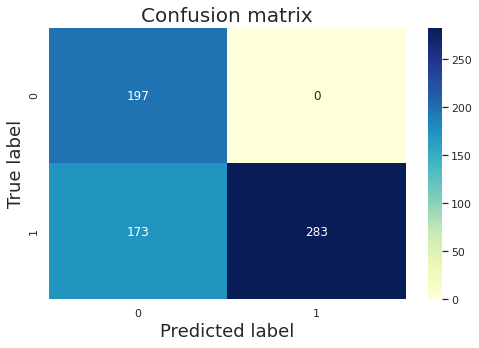

In [32]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
cm = confusion_matrix(act, pred_theshold)

import seaborn as sns
sns.set()
fig, ax = plt.subplots(figsize=(8, 5))

ax = sns.heatmap(cm , annot=True, fmt="d", cmap="YlGnBu") #Blues,Oranges,Reds
ax.set_title('Confusion matrix',fontsize=20)
ax.set_ylabel('True label',fontsize=18)
ax.set_xlabel('Predicted label',fontsize=18)

# Grad CAM

### - create dataframe for Grad CAM 

In [ ]:
#สร้าง folder เก็บรูป 
import os
import shutil

path0 = "/media/tohn/SSD/image/test_GradCam/B0_val" 

try:
    os.mkdir(path0)
except OSError:
    shutil.rmtree(path0)
    os.mkdir(path0)

In [ ]:
#สร้าง folder เก็บรูป 
import os
import shutil

path1 = path0+'/abn_correct/'
path2 = path0+'/abn_missing/'
path3 = path0+'/Nor_correct/'
path4 = path0+'/Nor_missing/'
try:
    os.mkdir(path1)
    os.mkdir(path2)
    os.mkdir(path3)
    os.mkdir(path4)
except OSError:
    shutil.rmtree(path1)
    shutil.rmtree(path2)
    shutil.rmtree(path3)
    shutil.rmtree(path4)
    os.mkdir(path1)
    os.mkdir(path2)
    os.mkdir(path3)
    os.mkdir(path4)

### - Abnormal 

In [ ]:
#load image function
def load_image(img_path):
    # Read the image and resize it
    img = image.load_img(img_path, target_size=(height, width))
    # Convert it to a Numpy array with target shape.
    x = image.img_to_array(img)
    # Reshape
    x = x.reshape((1,) + x.shape)
    x /= 255.
    return x,img

In [ ]:
df = dataframe
abnormal  = df[df['Class']=='Abnormal']
ab_correct = abnormal[abnormal['Class']==abnormal['category']] # correct
ab_wrong = abnormal[abnormal['Class']!=abnormal['category']]
#select position 
print('abnormal:',len(abnormal))
print('ab_correct:',len(ab_correct))
print('ab_wrong:',len(ab_wrong))
print(len(set(ab_correct['Sub Position'])))
print(set(ab_correct['Sub Position']))

####  ab_correct 

##### TF-explain 

In [ ]:
#### load only max &min prob of each views(P1,P2,P31,...,P72) *** For correct
max_df = list()
min_df = list()
classs = list(set(ab_correct['Sub Position']))
for i in classs:
    posi = ab_correct[ab_correct['Sub Position'] == i]
    #max
    max_prob = posi[posi['Prob'] == posi['Prob'].max()][0:1].reset_index()
    SubPosi = i
    case = 'ab_correct'
    case_prob = 'Max'
    prob = max_prob['Prob'].tolist()[0]
    path = max_prob['Path Crop'].tolist()[0]

    max_df.append({'Sub Position':SubPosi,'Case':case,'Case_prob':case_prob,'Prob':prob,'Path':path})
    
    #min
    min_prob = posi[posi['Prob'] == posi['Prob'].min()][0:1].reset_index()
    SubPosi = i
    case = 'ab_correct'
    case_prob = 'Min'
    prob = min_prob['Prob'].tolist()[0]
    path = min_prob['Path Crop'].tolist()[0]

    min_df.append({'Sub Position':SubPosi,'Case':case,'Case_prob':case_prob,'Prob':prob,'Path':path})
tabktdf = pd.DataFrame(max_df+min_df)
tabktdf

In [ ]:
img_paths = tabktdf['Path'].tolist()
case = tabktdf['Case_prob'].tolist()
prob = tabktdf['Prob'].round(4).tolist()
imlist = list()
idx = range(0,len(img_paths))
for i in idx :
    j = img_paths[i]
    imlist.append(j)
    j = j.split('/')[-1]
    os.chdir(path1)
    import cv2
    from matplotlib import pyplot as plt
    from tf_explain.core.grad_cam import GradCAM
    explainer = GradCAM()

    img,ori = load_image(img_paths[i])
    data = (img, None)

    grid = explainer.explain(data, model, class_index=0)
    
    explainer.save(grid,'.',"ab_cor_"+str(i)+"_"+str(case[i])+"_"+str(prob[i])+"_"+str(j)+".png")
print(len(imlist))

##### Load USAI image 

In [ ]:
from keras.preprocessing.image import load_img
from keras.preprocessing.image import save_img
# load the image
idx = imlist
for i in idx :
    j = i
    j = j.split('/')[-1]
    img = image.load_img(i)
    os.chdir(path1)
    save_img(str(j)+'.png', img)
print(len(imlist))

####  ab_wrong

In [ ]:
print('nor_wrong:',len(ab_wrong))
w_img_paths = ab_wrong['Path Crop'].tolist()
w_prob = ab_wrong['Prob'].round(4).tolist()
ab_wrong.shape

In [ ]:
imlist = list()
idx = range(0,len(w_img_paths))
for i in idx :
    j = w_img_paths[i]
    imlist.append(j)
    j = j.split('/')[-1]
#     print(j)
    os.chdir(path2)
    import cv2
    from matplotlib import pyplot as plt
    from tf_explain.core.grad_cam import GradCAM
    explainer = GradCAM()

    img,ori = load_image(w_img_paths[i])
    data = (img, None)

    grid = explainer.explain(data, model, class_index=0) 
    explainer.save(grid,'.',"Nor_missing_"+str(w_prob[i])+"_"+str(j)+"_"+str(i)+".png")
print(len(imlist))

#####  Load USAI image

In [ ]:
from keras.preprocessing.image import load_img
from keras.preprocessing.image import save_img
idx = imlist
for i in idx :
    j = i
    j = j.split('/')[-1]
    img = image.load_img(i)
    os.chdir(path2)
    save_img(str(j)+'.png', img)
print(len(imlist))

#### *Show Correct Abnormal GradCam*

In [ ]:
from tf_explain.core.grad_cam import GradCAM
explainer = GradCAM()
img,ori = load_image(img_paths[0])
data = (img, None)
grid = explainer.explain(data, model, class_index=1) 
explainer.save(grid, ".", "grad_cam.png")
print(img_paths[0])
plt.imshow(grid)

In [ ]:
import matplotlib.image as mpimg
img = mpimg.imread(img_paths[0])
plt.imshow(img)

#### *Show Miss Abnormal GradCam*

In [ ]:
from tf_explain.core.grad_cam import GradCAM
explainer = GradCAM()
img,ori = load_image(w_img_paths[0])
data = (img, None)
grid = explainer.explain(data, model, class_index=1) 
explainer.save(grid, ".", "grad_cam.png")
print(img_paths[0])
plt.imshow(grid)

In [ ]:
import matplotlib.image as mpimg
img = mpimg.imread(w_img_paths[0])
plt.imshow(img)

### Normal

In [ ]:
df = dataframe
normal  = df[df['Class']=='Normal']
nor_correct = normal[normal['Class']==normal['category']] # correct
nor_wrong = normal[normal['Class']!=normal['category']]
print('normal:',len(normal))
print('nor_correct:',len(nor_correct))
print('nor_wrong:',len(nor_wrong))
#select position 
print(len(set(nor_correct['Sub Position'])))
print(set(nor_correct['Sub Position']))

#### nor_correct 

##### TF-explain

In [ ]:
#### load only max &min prob of each views(P1,P2,P31,...,P72) *** For correct
max_df = list()
min_df = list()
classs = list(set(nor_correct['Sub Position']))
for i in classs:
    posi = nor_correct[nor_correct['Sub Position'] == i]
    #max
    max_prob = posi[posi['Prob'] == posi['Prob'].max()][0:1].reset_index()
    SubPosi = i
    case = 'nor_correct'
    case_prob = 'Max'
    prob = max_prob['Prob'].tolist()[0]
    path = max_prob['Path Crop'].tolist()[0]

    max_df.append({'Sub Position':SubPosi,'Case':case,'Case_prob':case_prob,'Prob':prob,'Path':path})
    
    #min
    min_prob = posi[posi['Prob'] == posi['Prob'].min()][0:1].reset_index()
    SubPosi = i
    case = 'nor_correct'
    case_prob = 'Min'
    prob = min_prob['Prob'].tolist()[0]
    path = min_prob['Path Crop'].tolist()[0]

    min_df.append({'Sub Position':SubPosi,'Case':case,'Case_prob':case_prob,'Prob':prob,'Path':path})
tabktdf = pd.DataFrame(max_df+min_df)
tabktdf

In [ ]:
#Load Grad Cam image

img_paths = tabktdf['Path'].tolist()
case = tabktdf['Case_prob'].tolist()
prob = tabktdf['Prob'].round(4).tolist()

imlist = list()
idx = range(0,len(img_paths))
for i in idx :
    j = img_paths[i]
    imlist.append(j)
    j = j.split('/')[-1]
    os.chdir(path3)
    import cv2
    from matplotlib import pyplot as plt
    from tf_explain.core.grad_cam import GradCAM
    explainer = GradCAM()

    img,ori = load_image(img_paths[i])
    data = (img, None)

    grid = explainer.explain(data, model, class_index=0) 
    explainer.save(grid,'.',"nor_cor_"+str(i)+"_"+str(case[i])+"_"+str(prob[i])+"_"+str(j)+".png")
print(len(imlist))

#####  Load USAI image

In [ ]:
from keras.preprocessing.image import load_img
from keras.preprocessing.image import save_img
# load the image
idx = imlist
for i in idx :
    j = i
    j = j.split('/')[-1]
    img = image.load_img(i)
    os.chdir(path3)
    save_img(str(j)+'.png', img)
print(len(imlist))

#### Normal Miss

In [ ]:
print('nor_wrong:',len(nor_wrong))

In [ ]:
w_img_paths = nor_wrong['Path Crop'].tolist()
w_prob = nor_wrong['Prob'].round(4).tolist()
nor_wrong.shape

In [ ]:
imlist = list()
idx = range(0,len(w_img_paths))
for i in idx :
    j = w_img_paths[i]
    imlist.append(j)
    j = j.split('/')[-1]
#     print(j)
    os.chdir(path4)
    import cv2
    from matplotlib import pyplot as plt
    from tf_explain.core.grad_cam import GradCAM
    explainer = GradCAM()

    img,ori = load_image(w_img_paths[i])
    data = (img, None)

    grid = explainer.explain(data, model, class_index=0) 
    explainer.save(grid,'.',"Nor_missing_"+str(w_prob[i])+"_"+str(j)+"_"+str(i)+".png")
print(len(imlist))

##### Load USAI image 

In [ ]:
from keras.preprocessing.image import load_img
from keras.preprocessing.image import save_img
idx = imlist
for i in idx :
    j = i
    j = j.split('/')[-1]
    img = image.load_img(i)
    os.chdir(path4)
    save_img(str(j)+'.png', img)
print(len(imlist))

##### *Show Correct NormalGradCam*

In [ ]:
from tf_explain.core.grad_cam import GradCAM
explainer = GradCAM()
img,ori = load_image(img_paths[0])
data = (img, None)
grid = explainer.explain(data, model, class_index=1) 
explainer.save(grid, ".", "grad_cam.png")
print(img_paths[0])
plt.imshow(grid)

In [ ]:
img = mpimg.imread(img_paths[0])
plt.imshow(img)

##### *Show Miss Normal GradCam*

In [ ]:
from tf_explain.core.grad_cam import GradCAM
explainer = GradCAM()
img,ori = load_image(w_img_paths[0])
data = (img, None)
grid = explainer.explain(data, model, class_index=1) 
explainer.save(grid, ".", "grad_cam.png")
print(img_paths[0])
plt.imshow(grid)

In [ ]:
img = mpimg.imread(w_img_paths[0])
plt.imshow(img)